In [1]:
import numpy as np
import aligator
import pinocchio as pin
import pinocchio.visualize
from pinocchio.robot_wrapper import RobotWrapper
import time
import math
from utils import load_talos_no_wristhead, ArgsBase
import matplotlib.pyplot as plt
import h5py
import os
import itertools
import copy
from IPython.display import HTML

from aligator import (
    manifolds,
    dynamics,
    constraints,
)

class Args(ArgsBase):
    tcp: str = None
    bounds: bool = True
    num_threads: int = 8
args = Args()

In [2]:
pinocchio.__version__

'3.4.0'

In [3]:
aligator.__version__

'0.12.0'

## Init robot

In [4]:
urdf_path = "../reddog/urdf/reddog_20250221.urdf"
mesh_dir = "../reddog/urdf/"
robot = RobotWrapper.BuildFromURDF(urdf_path, mesh_dir, root_joint = pin.JointModelFreeFlyer())

rmodel: pin.Model = robot.model
rdata: pin.Data = robot.data

In [5]:
vizer = pin.visualize.MeshcatVisualizer(
    rmodel, robot.collision_model, robot.visual_model, data=rdata
)
vizer.initViewer(open=False, loadModel=True)
vizer.display(pin.neutral(rmodel))

#vizer.setBackgroundColor()

You can open the visualizer by visiting the following URL:
http://127.0.0.1:7002/static/


In [6]:
nq = rmodel.nq
nv = rmodel.nv
nu = nv - 6

space = manifolds.MultibodyPhaseSpace(rmodel)
ndx = space.ndx

print("nq:", nq)
print("nv:", nv)
print("ndx:", ndx)

nq: 19
nv: 18
ndx: 36


## Get foot IDS

In [7]:
FOOT_FRAME_IDS = [rmodel.getFrameId(fname) for fname in ['FL_foot', 'FR_foot', 'RL_foot', 'RR_foot']]
FOOT_JOINT_IDS = [rmodel.frames[fid].parentJoint for fid in FOOT_FRAME_IDS]

# Get initial conditions

In [8]:
q0 = pin.neutral(rmodel)

# Initial condition (standing)
ang = 45*math.pi/180
q0[7:19] = [-0.4, ang, -2*ang, 0.4, ang, -2*ang, -0.4, -ang, 2*ang, 0.4, -ang, 2*ang]
pin.forwardKinematics(rmodel, rdata, q0)
pin.updateFramePlacements(rmodel, rdata)
q0[2] = -rdata.oMf[FOOT_FRAME_IDS[0]].translation[2]
pin.forwardKinematics(rmodel, rdata, q0)
pin.updateFramePlacements(rmodel, rdata)
space = manifolds.MultibodyPhaseSpace(rmodel)
x0 = np.concatenate((q0, np.zeros(nv)))
u0 = np.zeros(nu)
com0 = pin.centerOfMass(rmodel, rdata, x0[:nq])

vizer.display(q0)

# Set up Problem

In [9]:
# # import contact patterns
# import pickle

# # Path to your pkl file
# pkl_file_path = 'contact_patterns.pkl'

# # Load the contact patterns from the pkl file
# with open(pkl_file_path, 'rb') as f:
#     contact_patterns = pickle.load(f)

# # Now you can use the contact patterns
# print(f"Loaded {len(contact_patterns)} contact patterns")
# print(f"First 10 patterns: {contact_patterns[:10]}")

In [10]:
# Simulation time
dt = 0.01

# Contact phases and walk parameters
T_swing_two_legs = 36 # default: 36, phase time for two legs swing
T_swing_one_leg = 10 # default: 5, phase time for one leg swing

T_fs = 5 # full support
T_swing = 2*T_swing_two_legs+T_swing_one_leg # swing time
T_stance = 2*T_swing_two_legs+3*T_swing_one_leg # stance time
print(f"swing time: {T_swing}, stance time: {T_stance}")
swings_ap = [0.05, 0.05, 0.05, 0.05]
walk_speed = 0.1 # forward walk speed
# phase_length = 4*(T_fs+T_step)
contact_phases = (
    ['1111'] * T_fs
    + ['1011'] * T_swing_two_legs   # transition phase
    + ['1011'] * T_swing_one_leg   # start
    + ['1001'] * T_swing_two_legs
    + ['1101'] * T_swing_one_leg
    + ['0101'] * T_swing_two_legs   
    + ['0111'] * T_swing_one_leg
    + ['0110'] * T_swing_two_legs
    + ['1110'] * T_swing_one_leg
    + ['1010'] * T_swing_two_legs
    + ['1011'] * T_swing_one_leg   # start
    + ['1001'] * T_swing_two_legs
    + ['1101'] * T_swing_one_leg
    + ['0101'] * T_swing_two_legs
    + ['0111'] * T_swing_one_leg
    + ['0110'] * T_swing_two_legs
    + ['1110'] * T_swing_one_leg
    + ['1110'] * T_swing_two_legs  # transition phase
    + ['1111'] * T_fs
)
nsteps = len(contact_phases)

# Costs
foot_p = 1e-2
foot_v = 1e-1
w_x = np.diag(
    [1e2, 1e2, 1e5, 1e1, 1e1, 1e1, # body pos
     foot_p, foot_p, foot_p, foot_p, foot_p, foot_p, foot_p, foot_p, foot_p, foot_p, foot_p, foot_p, # leg pos
     1e2, 1e2, 1e3, 1e1, 1e1, 1e1, # body vel
     foot_v, foot_v, foot_v, foot_v, foot_v, foot_v, foot_v, foot_v, foot_v, foot_v, foot_v, foot_v])
w_u = np.eye(nu)*1e-5
w_foot = 1e3*np.eye(3)
w_com = np.diag([1e2, 1e2, 1e1])*1e2

act_matrix = np.eye(nv, nu, -6)

swing time: 82, stance time: 102


In [11]:
offset = 1+3*(T_fs)

In [12]:
# Create foot constraints
prox_settings = pin.ProximalSettings(1e-9, 1e-10, 10)
constraint_models = []
constraint_datas = []
for (i, fid) in enumerate(FOOT_FRAME_IDS):
    joint_id = FOOT_JOINT_IDS[i]
    pl1 = rmodel.frames[fid].placement
    pl2 = rdata.oMf[fid]
    cm = pin.RigidConstraintModel(
        pin.ContactType.CONTACT_3D,
        rmodel,
        joint_id,
        pl1,
        0,
        pl2,
        pin.LOCAL_WORLD_ALIGNED,
    )
    cm.corrector.Kp[:] = (1000, 1000, 1000)
    cm.corrector.Kd[:] = (50, 50, 50)
    constraint_models.append(cm)
    constraint_datas.append(cm.createData())

In [13]:
# Dynamics constraint function
def create_dynamics(mode, foot_targets):
    dyn_model = None
    constraints = []
    for i in range(4):
        if mode[i] == '1':
            joint_id = FOOT_JOINT_IDS[i]
            pl1 = rmodel.frames[fid].placement
            pl2 = rdata.oMf[fid]
            pl2.translation = foot_targets[i]
            cm = pin.RigidConstraintModel(
                pin.ContactType.CONTACT_3D,
                rmodel,
                joint_id,
                pl1,
                0,
                pl2,
                pin.LOCAL_WORLD_ALIGNED,
            )
            cm.corrector.Kp[:] = (1000, 1000, 1000)
            cm.corrector.Kd[:] = (50, 50, 50)
            constraints.append(cm)
    ode = dynamics.MultibodyConstraintFwdDynamics(space, act_matrix, constraints, prox_settings)
    return dynamics.IntegratorSemiImplEuler(ode, dt)

In [14]:
# Stage function (cost and dynamics)
pos = []
def createStage(i, mode, prev_mode, foot_targets):
    # Create stage running cost
    rcost = aligator.CostStack(space, nu)
    qnext = copy.deepcopy(q0)
    current_pos = np.mean(foot_targets, axis=0)[:2]
    pos.append(copy.deepcopy(current_pos))
    qnext[:2] = current_pos
    xnext = np.concatenate((qnext, np.zeros(nv)))
    
    rcost.addCost(aligator.QuadraticStateCost(space, nu, xnext, w_x)) # State cost
    rcost.addCost(aligator.QuadraticControlCost(space, u0, w_u)) # Control cost
    # com_res = aligator.CenterOfMassTranslationResidual(space.ndx, nu, rmodel, com0)
    # rcost.addCost(aligator.QuadraticResidualCost(space, com_res, w_com)) # CoM cost

    # TODO: forward walking cost

    # Swing foot tracking costs (translation only)
    for foot in range(4):
        if mode[foot] == '0':
            frame_pos = aligator.FrameTranslationResidual(space.ndx, nu, rmodel, foot_targets[foot], FOOT_FRAME_IDS[foot])
            rcost.addCost(aligator.QuadraticResidualCost(space, frame_pos, w_foot))

    stm = aligator.StageModel(rcost, create_dynamics(mode, foot_targets))

    # Add torque limits
    umax = rmodel.effortLimit[6:]
    umin = -umax
    stm.addConstraint(aligator.ControlErrorResidual(space.ndx, np.zeros(nu)), constraints.BoxConstraint(umin, umax))

    # Add touchdown constraints
    v_ref = pin.Motion()
    v_ref.np[:] = 0.0
    v_ref.np[0] = walk_speed
    for foot in range(4):
        if mode[foot] == '1' and prev_mode[foot] == '0':
            frame_pos = aligator.FrameTranslationResidual(space.ndx, nu, rmodel, foot_targets[foot], FOOT_FRAME_IDS[foot])
            frame_vel = aligator.FrameVelocityResidual(space.ndx, nu, rmodel, v_ref, FOOT_FRAME_IDS[foot], pin.LOCAL)[:3] # Translation only
            stm.addConstraint(frame_pos, constraints.EqualityConstraintSet())
            stm.addConstraint(frame_vel, constraints.EqualityConstraintSet())

    return stm

In [15]:
# Foot trajectory function
def ztraj(swing_apex, t_step, ts):
    # return swing_apex * (np.sin(ts / t_step * np.pi))
    return swing_apex * (-np.cos(2 * ts / t_step * np.pi) + 1)/2

def xtraj(dist, t_step, ts):
    return dist * (-np.cos(ts / t_step * np.pi) + 1)/2

In [16]:
# from cheetah import ztraj, xtraj, updateControlPointsHeight, updateControlPointsLength
from utils.animation_utils import create_foot_animation

In [17]:
# # Create foot reference
# foot_targets0 = [rdata.oMf[fid].translation for fid in FOOT_FRAME_IDS]
# dist = walk_speed * (T_fs + T_step) * dt * 2
# # updateControlPointsHeight(swing_apex)
# # updateControlPointsLength(dist)  
# foot_targets = []
# ts = 0
# for cp in contact_phases:
#     ts += 1
#     if cp == '1111':
#         ts = 0
#         foot_targets.append(copy.deepcopy(foot_targets0))
#     else:
#         foot_target = copy.deepcopy(foot_targets0)
#         for foot in range(4):
#             if cp[foot] == '0':
#                 foot_targets0[foot][0] += (xtraj(dist, T_step, ts) -xtraj(dist, T_step, ts-1))
#                 foot_target[foot][2] = ztraj(swing_apex, T_step, ts)
#         foot_targets.append(foot_target)

# stages = [createStage(0, contact_phases[0], '1111', foot_targets[0])]
# for i in range(1, nsteps):
#     stages.append(createStage(i, contact_phases[i], contact_phases[i - 1], foot_targets[i]))

In [18]:
# T_fs = 154# full support knots
# T_step = 40 # step knots

# Create foot reference
foot_targets0 = [rdata.oMf[fid].translation for fid in FOOT_FRAME_IDS]
dist = walk_speed * (T_swing + T_stance) * dt #* 2
# updateControlPointsHeight(swing_apex)
# updateControlPointsLength(dist)  
foot_targets = []

# Initialize separate time counters for each leg
leg_ts = [0, 0, 0, 0]  # One counter for each of the 4 legs

for cp in contact_phases:
    foot_target = copy.deepcopy(foot_targets0)
    
    for foot in range(4):
        if cp[foot] == '0':  # Leg is in swing phase
            leg_ts[foot] += 1
            # Update horizontal position
            foot_targets0[foot][0] += (xtraj(dist, T_swing, leg_ts[foot]) - xtraj(dist, T_swing, leg_ts[foot]-1))
            # Update vertical position (height) for foot target
            foot_target[foot][2] = ztraj(swings_ap[foot], T_swing, leg_ts[foot])
        elif cp[foot] == '1':  # Leg makes contact
            # Reset counter when leg touches ground
            leg_ts[foot] = 0
            # When contact is made, update the reference position for this foot
            foot_target[foot] = copy.deepcopy(foot_targets0[foot])
            
    foot_targets.append(copy.deepcopy(foot_target))

stages = [createStage(0, contact_phases[0], '1111', foot_targets[0])]
for i in range(1, nsteps):
    stages.append(createStage(i, contact_phases[i], contact_phases[i - 1], foot_targets[i]))

In [19]:
qf = copy.deepcopy(q0)
qf[:2] = np.mean(foot_targets[-1], axis=0)[:2]
xf = np.concatenate((qf, np.zeros(nv)))

term_cost = aligator.CostStack(space, nu)
term_cost.addCost(aligator.QuadraticStateCost(space, nu, xf, 100 * w_x)) # Terminal state cost

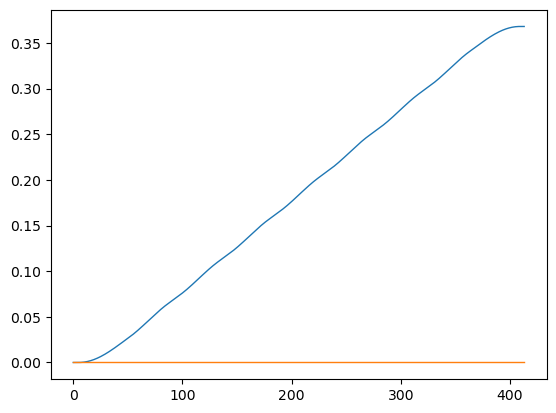

In [20]:
plt.plot(pos)

Animation size has reached 21002634 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


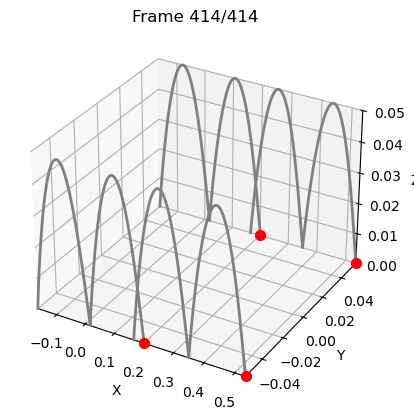

In [28]:
# Create the animation
ani = create_foot_animation(foot_targets, interval=100)
# Display the animation
HTML(ani.to_jshtml())

In [23]:
%%time
problem = aligator.TrajOptProblem(x0, stages, term_cost)

TOL = 1e-4
mu_init = 1e-8
max_iters = 200
verbose = aligator.VerboseLevel.VERBOSE
solver = aligator.SolverProxDDP(TOL, mu_init, verbose=verbose)
# solver = aligator.SolverFDDP(TOL, verbose=verbose)
solver.rollout_type = aligator.ROLLOUT_LINEAR
# solver = aligator.SolverFDDP(TOL, verbose=verbose)
solver.max_iters = max_iters
solver.sa_strategy = aligator.SA_FILTER  # FILTER or LINESEARCH
solver.filter.beta = 1e-5
solver.force_initial_condition = True
solver.reg_min = 1e-6
solver.linear_solver_choice = aligator.LQ_SOLVER_PARALLEL  # LQ_SOLVER_SERIAL
solver.setNumThreads(args.num_threads)
solver.setup(problem)

us_init = [np.zeros(nu)] * nsteps
xs_init = [x0] * (nsteps + 1)

solver.run(
    problem,
    xs_init,
    us_init,
)
workspace = solver.workspace
results = solver.results
print(results)


def fdisplay():
    qs = [x[:nq] for x in results.xs.tolist()]

    for _ in range(1):
        vizer.play(qs, dt)
        # time.sleep(0.5)
fdisplay()

─iter─┬───alpha───┬─inner_crit─┬─prim_err──┬─dual_err──┬───preg────┬───cost────┬───dphi0────┬───merit───┬─────ΔM─────┬─aliter─┬───mu───
Results {
  num_iters:    26,
  converged:    true,
  traj. cost:   5.329e+02,
  merit.value:  5.329e+02,
  prim_infeas:  3.147e-06,
  dual_infeas:  3.107e-05,
  al_iters:     0,
}
    1 │ 1.000e+00 │  3.680e+03 │ 2.177e+01 │ 3.680e+03 │ 1.000e-06 │ 1.639e+03 │ -1.584e+16 │ 2.684e+15 │ -5.237e+15 │      1 │  1e-08 
    2 │ 1.000e+00 │  4.580e+02 │ 2.213e+02 │ 4.580e+02 │ 1.000e-06 │ 1.623e+03 │ -5.368e+15 │ 2.044e+15 │ -6.400e+14 │      1 │  1e-08 
    3 │ 1.000e+00 │  1.182e+03 │ 1.634e+02 │ 1.182e+03 │ 1.000e-06 │ 2.283e+03 │ -4.088e+15 │ 1.940e+15 │ -1.045e+14 │      1 │  1e-08 
    4 │ 1.000e+00 │  2.779e+03 │ 1.352e+02 │ 2.779e+03 │ 1.000e-06 │ 1.276e+03 │ -3.879e+15 │ 4.300e+14 │ -1.510e+15 │      1 │  1e-08 
    5 │ 1.000e+00 │  5.724e+02 │ 6.232e+01 │ 5.724e+02 │ 1.000e-06 │ 7.012e+02 │ -8.599e+14 │ 3.755e+14 │ -5.443e+13 │      1 │  1e-08 
   

In [24]:
fdisplay()

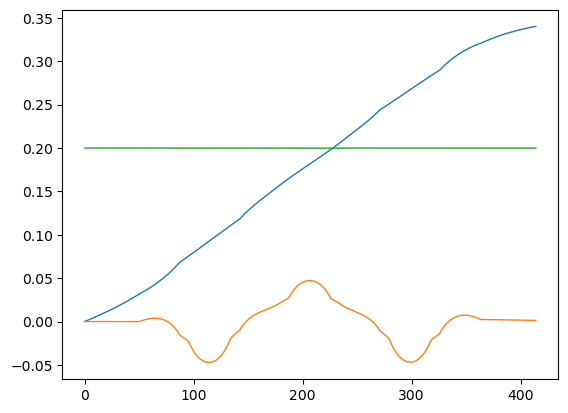

In [25]:
plt.plot(np.array(results.xs.tolist())[:,:3]);

In [26]:
results.xs

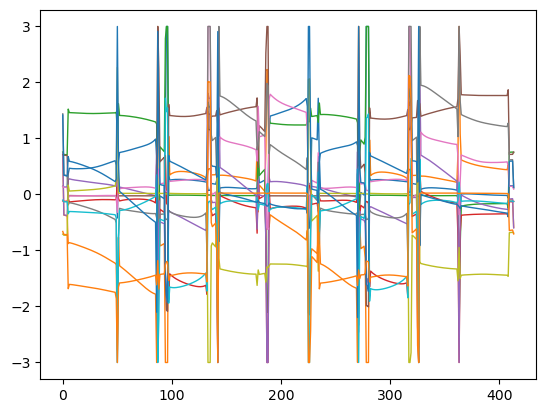

In [27]:
plt.plot(results.us.tolist());